In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import copy
from queue import PriorityQueue
import random
from itertools import count

# Image Shuffling

In [2]:
def Random_Shuffle(linear:list(),blank_i,num_patches,x:int = 100):
    
    for i in range(x):
        row = blank_i // num_patches # get current position of blank
        col = blank_i % num_patches
        neighbor_indices = []
        # Check above
        if row > 0:
            neighbor_indices.append((row - 1) * num_patches + col)
        # Check left
        if col > 0:
            neighbor_indices.append(row * num_patches + (col - 1))
        # Check right
        if col < num_patches - 1:
            neighbor_indices.append(row * num_patches + (col + 1))
        # Check below
        if row < num_patches - 1:
            neighbor_indices.append((row + 1) * num_patches + col)
        
        new_blank = random.choice(neighbor_indices) # from list of all possible moves randomly swap blank
        temp = linear[blank_i]
        linear[blank_i] = linear[new_blank]
        linear[new_blank] = temp
        blank_i = new_blank
            
    return linear

Original Image: 


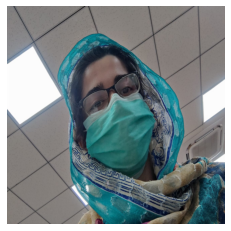

In [3]:
linear = list()
    
def Image_Puzzle(path_img:str, patch_size:int = 16):
    img = Image.open(path_img)
    img = img.resize((512,512))
    print("Original Image: ")
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    img = np.asarray(img)
    img_size = img.shape[0]
    
    num_patches = img_size//patch_size  # 512//64 => num_patches = 8
    
    for i,patch_height in enumerate(range(0, img_size, patch_size)):
        for j,patch_width in enumerate(range(0, img_size, patch_size)):
            image = img[patch_height:patch_height+patch_size, #patch 0 = [0:0+64,0:0+64] ,patch 1 = [64:64+64,64:64+64] 
                      patch_width:patch_width+patch_size]
            linear.append(image)
    linear[-1] = np.zeros_like(image) # last img patch will be blank
    linear2 = linear.copy() # copy original to shuffle it
    
    Random_Shuffle(linear2,len(linear2)-1,num_patches)

    #Graph making
    shuffled_grid = {}
    original_grid = {}
    i = 0
    for x in range(0,num_patches):
        for y in range(0,num_patches):
            if np.array_equiv(linear2[i],np.zeros_like(image)): # if blank is found in shuffle save it's index
                blank = (x,y)
            shuffled_grid[(x,y)] = linear2[i] 
            original_grid[(x,y)] = linear[i]
            i+=1
        
    return original_grid, shuffled_grid , blank ,num_patches

original_grid, shuffled_grid ,blank, num_patches= Image_Puzzle('MyPic.jpeg',64)       #Returns two grids: 1. original, 2. Shuffled
                                                                                   # 3.Blank square (x,y) in shuffled grid, 4.num_patches

                                                            #last portion of grid i.e grid[(63,63)] is blank with color of black




In [4]:
def plot_grid(grid:dict(), num_patches = 32):
    img = 0
    for i in range(0,num_patches):
        patch = grid[i,0]
        for j in range(1,num_patches):
            patch = np.hstack((patch,grid[i,j]))

        if (isinstance(img, int)): # if img =0, means there is no row appended
            img = patch
        else:
            img = np.vstack((img,patch)) #vertically stack all rows
    plt.imshow(img)
    plt.axis(False)
    plt.show()

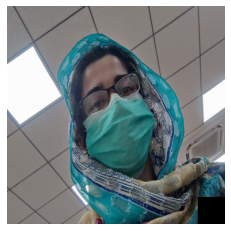

In [5]:
plot_grid(original_grid,num_patches)

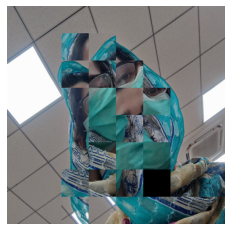

In [6]:
plot_grid(shuffled_grid,num_patches)

In [7]:
def get_states(): # mapping img np arrays into 2D np array of numbers
    
    new_goal_dict = {}
    initial_list = []
    
    for goal_index_tuple in original_grid.keys():

        for shuffle_index_tuple in shuffled_grid.keys():

            # if current array of goal is same as current array of shuffled
             if(np.array_equiv(original_grid[goal_index_tuple],shuffled_grid[shuffle_index_tuple])):
                    
        # in dict, against original goal img index, store the shuffled img index as => (6,5) : (6,3) => (6,5) : 63, means that 
        # the array at index (6,5) of goal is equal to the index (6,3) of shuffled array if filled acc to this formula
        
                    new_goal_dict[goal_index_tuple] =  (shuffle_index_tuple[0] * 10) + shuffle_index_tuple[1]
                    initial_list.append((goal_index_tuple[0] * 10) + goal_index_tuple[1])
                
        # if we pick each element in order from shuffled grid, we get shuffled image but if we pick each element form shuffled 
        # grid in order of new_goal_dict, we get goal state
                    
    goal_state = np.array(list(new_goal_dict.values()))
    goal_state = goal_state.reshape(8,8)

    initial_state = np.array(initial_list)
    initial_state = initial_state.reshape(8,8)
    
    return initial_state,goal_state

In [8]:
initial_state,goal_state = get_states()

In [9]:
initial_state

array([[ 0,  1,  2,  3,  4,  5,  6,  7],
       [10, 11, 12, 13, 14, 15, 16, 17],
       [20, 21, 22, 23, 24, 25, 26, 27],
       [30, 31, 32, 33, 34, 35, 36, 37],
       [40, 41, 42, 43, 44, 45, 46, 47],
       [50, 51, 52, 53, 54, 55, 56, 57],
       [60, 61, 62, 63, 64, 65, 66, 67],
       [70, 71, 72, 73, 74, 75, 76, 77]])

In [10]:
goal_state

array([[ 0,  1,  2,  3,  4,  5,  6,  7],
       [10, 11, 13, 22, 14, 15, 16, 17],
       [20, 21, 12, 34, 23, 25, 26, 27],
       [30, 31, 32, 24, 35, 45, 36, 37],
       [40, 41, 42, 33, 54, 44, 46, 47],
       [50, 51, 52, 43, 55, 64, 56, 57],
       [60, 61, 72, 62, 53, 63, 66, 67],
       [70, 71, 73, 74, 75, 76, 77, 65]])

In [11]:
def create_image(state):
    
    rows , cols = state.shape
    
    complete_array = np.array([])
    
    for r in range(0,rows):
        complete_row = np.array([])
        
        for c in range(0,cols):
            
            # (6,3) in state means array equal to shuffle_dict[(6,3)]
            array = shuffled_grid[(state[r,c]//10),(state[r,c]%10)] # gets 1 corresponding array
            
            if(complete_row.shape[0] == 0): #if array in which each row is stored is empty
                complete_row = array
            else:      # if array is not empty then horizontally concat it with arrays that are already there
                complete_row = np.concatenate((complete_row,array),axis=1)
                
                
        if(complete_array.shape[0] == 0):      # if final_array is empty
            complete_array = complete_row       # add first row
        else:         # if not empty then vertically append rows
            complete_array = np.concatenate((complete_array,complete_row),axis=0)
            
    return complete_array

# A* Search

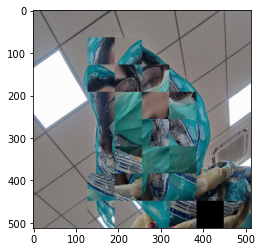

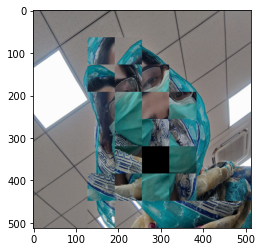

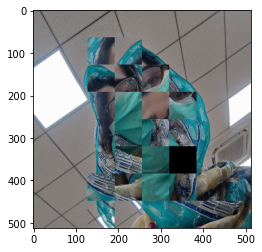

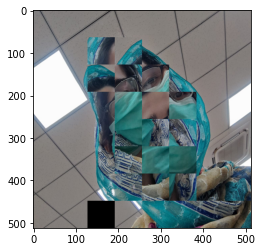

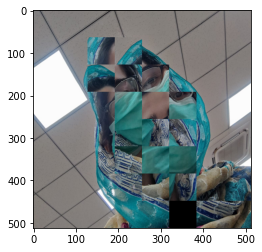

...

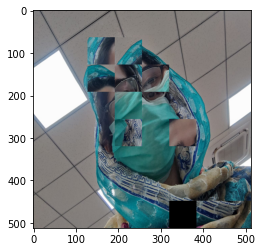

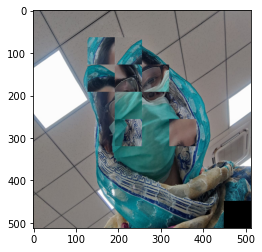

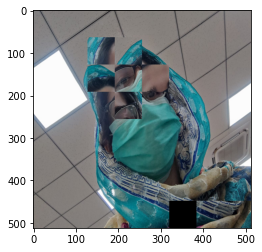

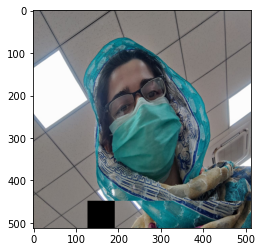

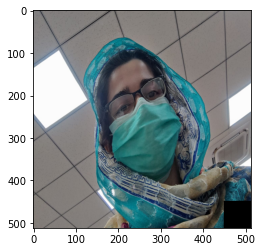

In [12]:
p_queue = PriorityQueue()
unique_counter = count()
closed_list = []

def check_similar_to_any_parent(state):

    for arr in closed_list: # check if current state is equal to any state in closed state or not
        if (np.array_equiv(state, arr)):
            return True
    return False
    

def get_hn(state:np.array,goal:np.array):
    
    unequal_pos = np.where(state != goal) 
    # returns (array([0, 0, 0, 2, 2, 2], dtype=int64),array([0, 1, 2, 0, 1, 2], dtype=int64)) => (row_nos,col_nos)
    # len of anyone is equal to no of unequal positions
    return len(unequal_pos[0])

def get_gap_index(state:np.array): # find index of the blank (black box in image)
    
    gap = (blank[0]*10) + blank[1] # if blank = (6,3) => gap = 63
    
    row_number = np.where(state == gap)[0][0] # return = (row_no, col_no) = (array([2], dtype=int64), array([0], dtype=int64))
    col_number = np.where(state == gap)[1][0]   
    return row_number , col_number


def generate_possibilities(state,grid_height,grid_width,gn):

    gap_row_number,gap_col_number = get_gap_index(state)

    possibility_1 = np.array([])
    possibility_2 = np.array([])
    possibility_3 = np.array([])
    possibility_4 = np.array([])

    closed_list.append(state)


    # top
    if(gap_row_number!=0): # if blank can be moved upwards
        temp = copy.deepcopy(state)
        num = temp[gap_row_number-1][gap_col_number]
        temp[gap_row_number-1][gap_col_number] = temp[gap_row_number][gap_col_number] 
        temp[gap_row_number][gap_col_number] = num
        possibility_1 = temp

        
    # left
    if(gap_col_number!=0):
        temp = copy.deepcopy(state)
        num = temp[gap_row_number][gap_col_number-1]
        temp[gap_row_number][gap_col_number-1] = temp[gap_row_number][gap_col_number] 
        temp[gap_row_number][gap_col_number] = num
        possibility_2 = temp
        
    
    # right
    if(gap_col_number < grid_width-1):
        temp = copy.deepcopy(state)
        num = temp[gap_row_number][gap_col_number+1]
        temp[gap_row_number][gap_col_number+1] = temp[gap_row_number][gap_col_number] 
        temp[gap_row_number][gap_col_number] = num
        possibility_3 = temp
        
    
    # down
    if(gap_row_number < grid_height-1):
        temp = copy.deepcopy(state)
        num = temp[gap_row_number+1][gap_col_number]
        temp[gap_row_number+1][gap_col_number] = temp[gap_row_number][gap_col_number] 
        temp[gap_row_number][gap_col_number] = num
        possibility_4 = temp

        
    gn += 1 # inc of 1 in gn of parent as all 4 possibilites are children of same parent
    return possibility_1 , possibility_2 , possibility_3 , possibility_4 , gn


def cycle(state:np.array,goal:np.array,grid_height,grid_width,gn):

    ps_1 , ps_2 , ps_3 , ps_4 , gn = generate_possibilities(state,grid_height,grid_width,gn)
    
    if(len(ps_1)!=0): #if moving up was not possible then it will be empty
        if(not check_similar_to_any_parent(ps_1)): # if not in closed list
            fn = gn + get_hn(ps_1,goal) # calculate fn
            p_queue.put((fn,next(unique_counter),gn,ps_1)) # put in priority queue

    if(len(ps_2)!=0):
        if(not check_similar_to_any_parent(ps_2)):
            fn = fn = gn + get_hn(ps_2,goal)
            p_queue.put((fn,next(unique_counter),gn,ps_2))
    
    if(len(ps_3)!=0):
        if(not check_similar_to_any_parent(ps_3)):
            fn = gn + get_hn(ps_3,goal)
            p_queue.put((fn,next(unique_counter),gn,ps_3))

    if(len(ps_4)!=0):
        if(not check_similar_to_any_parent(ps_4)):
            fn = gn + get_hn(ps_4,goal)
            p_queue.put((fn,next(unique_counter),gn,ps_4))
            

grid_height = 8
grid_width = 8

cycle(initial_state,goal_state,grid_height,grid_width,gn=0) #1st iteration
iteration = 1

while(not p_queue.empty()):
    
    fn,counter,gn,curr_state = p_queue.get() # dequeue state with least fn
    
    if(np.array_equiv(curr_state,goal_state)): # if goal state is found
        
        image = create_image(curr_state)
        plt.figure()
        plt.imshow(image)
        plt.show()
        del image
#         print(curr_state)
        break
    else:
        cycle(curr_state,goal_state,grid_height,grid_width,gn)
        iteration +=1
        
    if(iteration%5==0): #show image at every 5th iteration
        
        image = create_image(curr_state)
        
        plt.figure()
        plt.imshow(image)
        plt.show()
        del image
        
        print("\n\n")